# __Positium Data Analyst/Scientist Task__

In this task, I will perform the following

- Load in the dataset and the necessary Python packages.
- Sort the data by user and timestamp
- Group by user ID and calculate duration of successsive records. Fill missing values with zero value to indicate starting point
- Visualise user mobility duration using a histogram and filter out rows with zero (indicate start point), to calculate the mean duration of trips (in minutes). This will help in defining an appropriate threshold for defining user stays
- Convert the coordinates into grids (area). We will use the hexagonal gridding system using the `H3` package.
- Assign a variable to indicate stays if duration is above defined threshold or area is not equal to the area in previous time. Because this record spans user records within a given number of days, we need to consider trips that started the next day, hence we need to reset stay calculation at midnight so that stays are not carried over to the next day. As a result, we will extract time-related features such as hour of day and trip date, from the timestamp
- Next is to use the cumulative sum of stay indicator to assign IDs to each stays to enable aggregation
- After that, record would be aggregated by grouping by user ID, stay ID, hour of day, day of record and area (location) to obtain, start time, end time, stay duration, and the number of records in the stay (This would capture user mobility behaviour at a particular hour of the day).


In [1]:
! pip install h3 reverse_geocoder --q

## Task 1: __Loading data and preliminary EDA__

Here, we will load in the dataset and perform some preliminary exploratory data analysis

- Preliminary EDA would be to check for missing values, duplicate rows and data types
- Next, we will sort the timestamps of each user in ascending order and extract duration from the each user timestamp by calculating the distance between a point to another.
- We will extract time-related features such as the date and hour of commute.
- We will visualize the locations using a map.
- We will check the distribution of the durations to understand how long a user commutes.

In [2]:
import pandas as pd
import geopandas as gpd
import folium
import plotnine as pn
import h3
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from tqdm import tqdm
from geopy.geocoders import Nominatim
import reverse_geocoder as rg
import  time
from folium import plugins

In [3]:
pd.set_option('display.max_columns', None)

In [4]:
data = pd.read_csv('mobile_events.csv')
data.head()

,user_id,longitude,latitude,timestamp,horizontal_accuracy
0,1,55.32191,25.27729,2023-11-06 06:55:34,3.0
1,1,55.32197,25.27724,2023-11-06 06:55:35,3.0
2,1,55.32196,25.27723,2023-11-06 06:55:41,3.0
3,1,55.32206,25.27720,2023-11-06 08:06:07,10.0
4,1,55.32205,25.27720,2023-11-06 08:06:54,10.0


In [5]:
# Preliminary data exploration
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 277270 entries, 0 to 277269
Data columns (total 5 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   user_id              277270 non-null  int64  
 1   longitude            277270 non-null  float64
 2   latitude             277270 non-null  float64
 3   timestamp            277270 non-null  object 
 4   horizontal_accuracy  277240 non-null  float64
dtypes: float64(3), int64(1), object(1)
memory usage: 10.6+ MB


In [6]:
data.duplicated().sum()

0

- No missing values
- No duplicate rows
- Convert timestamp to datetime

In [7]:
# convert timestamp to date time
data = data.assign(timestamp = pd.to_datetime(data['timestamp']))

In [8]:
# extract time/date related features
data = data.assign(date = pd.to_datetime(data.timestamp.dt.date),
                   dayname = data.timestamp.dt.day_name().apply(lambda x: x[:3]),
                   hour = data.timestamp.dt.hour)

In [9]:
data.timestamp.min(), data.timestamp.max()

(Timestamp('2023-11-01 00:00:10'), Timestamp('2023-11-07 23:59:55'))

In [10]:
print('Number of users:', data.user_id.nunique())
print('Record day span:', (data.date.max() - data.date.min()).days + 1)

Number of users: 903
Record day span: 7


- Dataset spans a 7-day commute of users (903 users)

__Creating duration of stops by each user__

- We will do this by grouping by user and getting the difference (time in seconds) between the current time and previous timestamp
- We will fill missing rows with 0 to indicate the start time

In [11]:
# sort by user ID and timestamp
data = data.sort_values(['user_id', 'timestamp'])

__Create day of record and duration (in seconds) of successive records__

In [12]:
# get user day trips
data['day'] = (data.groupby(['user_id']).date.diff().dt.days.fillna(0) + 1).astype(int)
data['duration'] = data.groupby('user_id').timestamp.diff().dt.total_seconds().fillna(0)

In [13]:
# average user duration in mins (excluding 0 (start time))
mean_duration = data.query('duration != 0').duration.mean() / 60

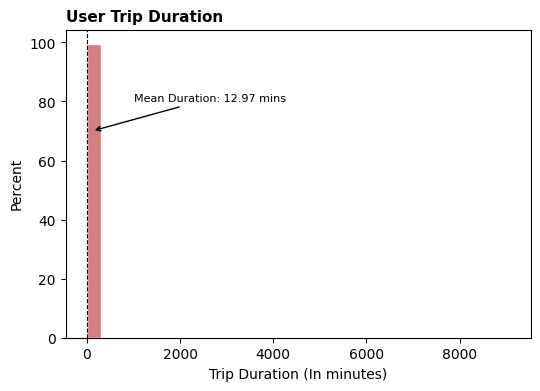

In [14]:
# visualising user durations
plt.figure(figsize=(6,4))
sns.histplot(data.query('duration != 0').duration/60, alpha=0.8,
             color='indianred', bins=30, edgecolor='w', stat='percent')
plt.title('User Trip Duration', loc='left', fontdict=dict(fontsize=11, fontweight='bold'))
plt.axvline(mean_duration, linestyle='--', color='black', linewidth=0.8)
plt.annotate(f'Mean Duration: {mean_duration:.2f} mins',
             fontsize=8,
             xy=(mean_duration+100, 70),
             xytext=(mean_duration+1000, 80),
             arrowprops=dict(facecolor='black', arrowstyle='->',
                             connectionstyle = "arc, angleA = 0, angleB = 0, rad = 0")
             )
plt.xlabel('Trip Duration (In minutes)')
plt.show()

- Majority of trips are below 1000 minutes
- The average duration is 12.97 minutes. We would define a threshold for stay to be stays at least 15 minutes.
- There are anomalies in the data with durations more than 24 hours. We can filter out durations that are more than 24 hours to indicate a day's commute but in this case we will decide not to leave them. It is possible that these commutes are to longer destinations. They can be useful to know the average distance these durations are.

__Map visualisation__

Here, we will visualise the commute coordinates in a map and overlay the points

We will get the longitude and latitude of UAE

In [15]:
# get information about UAE
geolocator = Nominatim(user_agent='UAE_bbox')
uae = geolocator.geocode('UAE')

In [16]:
# get UAE bounding box
uae_bbox = list(map(lambda x: float(x), uae.raw['boundingbox']))
min_lat=uae_bbox[0]; min_lon=uae_bbox[2]; max_lon=uae_bbox[3]; max_lat=uae_bbox[1]

In [17]:
bbox = [[uae_bbox[i], uae_bbox[i+2]] for i in range(len(uae_bbox)-2)]

In [18]:
m = folium.Map(location=(uae.latitude, uae.longitude), tiles="CartoDB Voyager", zoom_start=7, max_bounds=True,
               min_lat=min_lat, min_lon=min_lon, max_lon=max_lon, max_lat=max_lat)
# m.fit_bounds(bbox)
m.add_child(plugins.HeatMap(data[['latitude', 'longitude']], radius=10))

- User mobilities are clustered around 4-5 regions: Dubai, Abu Dhabi, Alain, Fujairah, Ras Al Khaimah etc

## __Task 2: Transforming spatial units to meaningful area__

We will use the hexagonal gridding system to do that.

In [19]:
# assign grids (using a resolution of 8)
data['area'] = data.apply(lambda x: h3.latlng_to_cell(x.latitude, x.longitude, 8), axis=1)

In [20]:
grid_areas = data['area'].drop_duplicates().reset_index(drop=True).to_frame()

In [21]:
center_locations = grid_areas.area.apply(lambda x: h3.cell_to_latlng(x))

In [22]:
grid_areas['center_lat'] = center_locations.apply(lambda x: x[0]).values
grid_areas['center_lon'] = center_locations.apply(lambda x: x[1]).values

In [23]:
areas = data['area'].unique()
print('Number of grid areas:', len(areas))

Number of grid areas: 2202


## __Task 3: Aggregating data to creating meaningful stays__

A stay refers to a period of time an individual remains in a specific location for a longer time, meaning that they are stationary and not on transit. From the duration distribution, the average duration of users is about 13 minutes indicating that most of the user stays are short. There are a lot of activities that can be done in this short time. These include,

- Running quick errands like going to the grocery stores or picking up an order.
- Transit-related activities such as waiting at bus stops or train stations to continue their journey or changing between mode of transporation.
- Recreational, socialising or sporting activities such as taking a quick walk in parks or visiting or dropping off a friend at a location, or visiting the gym for a quick exercise etc.

In [24]:
(data.query('duration > 0').duration/60).describe(percentiles=[0.25,0.50,0.75,0.90, 0.925, 0.95]).to_frame().T

,count,mean,std,min,25%,50%,75%,90%,92.5%,95%,max
duration,270262.0,12.966098,139.417713,0.016667,0.016667,0.066667,0.666667,11.8,17.85,29.9325,9068.433333


In [25]:
# binning users durations
duration_bins = pd.cut(data.duration, bins=[-np.Inf, 60, 5*60, 10*60, 15*60, 30*60, 60*60, np.Inf],
                       right=False,
                       labels=['<1min', '1-5min', '5-10min', '10-15min', '15-30min', '30-60min', '>=1hr'])

Let's bin the duration into 7 groups: <1min, 1-5min (not inclusive), 5-10min, 10-15, 15-30, 30-60, >=1hour

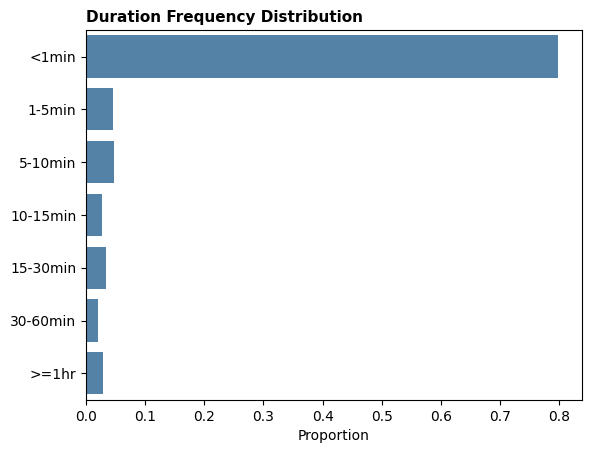

In [26]:
plt.figure()
sns.countplot(duration_bins, stat='proportion', color='steelblue')
plt.title('Duration Frequency Distribution', loc='left', fontsize=11, fontweight='bold')
plt.xlabel('Proportion'); plt.ylabel('');

By binning user duration, we see that majority (about 80%) of the movements were less than 1 min. Possibly, users are walking short distances to a very nearby place. Also, there are more movements between 1 and 10 mins (not inclusive) and fewer between 10-15 minutes.

On the other hand, a summary of the distribution above shows that 90% of the distribution have durations less than 11.8 minutes; 5% above 29.93 minutes. Hence, we'd want to be in the middle. Therefore, we'd define a stay as when a user remains at an area for at least 15 minutes. This is to reduce the amount of noise by including many transit users or missing out on significant stays that last for at least 15 minutes.

<br>

__Aggregation Approach__

Before aggregating the data, we'd create a variable called `distance` that provides information on the distance covered by a user from each record. This will be aggregated to determine the total distance moved by the user from that stay till the next stay whether within or outside the grid area. To aggregate the data, we'd follow these steps:

- Group by each user
- Get their previous and next locations (grid area) using `.shift` method
- Create two boolean variables called `stay start` and `end`. `Stay start` monitors where a stay occurs while `stay end` monitors if the current grid area is not the same as the next grid area. It is set to True to indicate the end of the user record if the user never left the grid area.
- A `start time` that tells the last timestamp preceding stay
- A `stay ID` that assigns an ID to all stay start for each user. This will be incremented cumulatively with more user stay starts.
- A `stay record` that counts the number of times a user stayed at least 15 minutes within the area
- A `stay distance` that sums the total distance covered by the user in that grid from stay start time to end time
- A `stay duration` that adds the total time spent by the user in that grid from stay start time to end time
- An `is_overnight` variable that checks if the end time is greater than the midnight of the start time
- An `average_speed` variable that calculates the total distance travelled by `duration`

In [27]:
def calculate_distance(loc1, loc2, unit='km'):
    """
    Calculates the Harversine Distance between two points
    loc1|loc2 : (longitude, latitude)
    """
    R = 6371.0 # in KM
    if not isinstance(loc1, list) or not isinstance(loc2, list):
        loc1, loc2 = map(list, (loc1, loc2))
    loc1, loc2 = map(np.deg2rad, [loc1, loc2])
    loc_diff = loc2 - loc1
    lat1, lon1 = loc1[1], loc1[0]
    lat2, lon2 = loc2[1], loc2[0]
    lat_d, lon_d = loc_diff[1], loc_diff[0]

    a = (np.sin(lat_d/2)**2) + np.cos(lat1) * np.cos(lat2) * (np.sin(lon_d/2)**2)
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1-a))

    distance = c * R

    if unit in ['m', 'meters']:
        return distance * 1000
    else:
        return distance

In [28]:
users = data.user_id.unique().tolist()

In [29]:
all_user_distances = []
for user in tqdm(users, desc='Calculating User distances'):
    user_data = data.query(f'user_id == {user}') # get user data
    # get number of locations of user
    num_locations = len(user_data)
    longitudes = user_data.longitude.values.tolist()
    latitudes = user_data.latitude.values.tolist()
    user_distance = [0] # add 0 to indicate starting point
    for i in range(num_locations-1):
        loc1 = [longitudes[i], latitudes[i]]
        loc2 = [longitudes[i+1], latitudes[i+1]]
        user_distance.append(calculate_distance(loc1, loc2))
    all_user_distances.extend(user_distance)

all_user_distances = np.array(all_user_distances)

Calculating User distances: 100%|██████████| 903/903 [00:10<00:00, 83.17it/s]


In [30]:
data['distances'] = all_user_distances

In [31]:
def obtain_user_stays(df, threshold=15*60):
    """
    Aggregates user stays and returns significant stays based on selected thresholds
    """
    df_copy = df.copy()
    df_copy['is_stay'] = 1*(df_copy.duration >= threshold)
    df_copy['previous_area'] = df_copy.groupby('user_id').area.shift(1)
    df_copy['next_area'] = df_copy.groupby('user_id').area.shift(-1)
    df_copy['stay_start'] = df_copy['is_stay'] == 1 # start if is_stay
    df_copy['stay_end'] = (df_copy['next_area'] != df_copy['area']).fillna(True) # update last record for user as stay end
    df_copy['stay_start'] = df_copy['stay_start'].astype(int)
    df_copy['stay_id'] = df_copy.groupby('user_id')['stay_start'].cumsum() # stay ID (increment for each user)
    df_copy['start_time'] = df_copy.groupby('user_id').timestamp.shift(1) # time preceding stay occurrence


    # get stay records and distances for each user's stays ID in every grid area
    stay_records = df_copy.groupby(['user_id', 'stay_id', 'area']).size()
    stay_records.name = 'n_records_in_stay'
    stay_records = stay_records.reset_index()

    stay_distances = df_copy.groupby(['user_id', 'stay_id', 'area']).distances.sum()

    stay_durations = df_copy.groupby(['user_id', 'stay_id', 'area']).duration.sum()

    # filter out rows with stay start and end values as True
    stay_start = df_copy.query('stay_start == 1')[['user_id', 'start_time', 'area', 'stay_id']]
    stay_end = df_copy.query('stay_end == True')[['user_id', 'timestamp', 'area', 'stay_id']].rename(
        columns={'timestamp':'end_time'})
    user_stays = pd.merge(stay_start, stay_end, on=['user_id', 'area', 'stay_id'], how='inner')
    # user_stays['duration'] = (user_stays.end_time - user_stays.start_time).dt.total_seconds()
    user_stays = user_stays.merge(stay_durations, on = ['user_id', 'stay_id', 'area'], how='inner')
    user_stays = user_stays.merge(stay_records, on = ['user_id', 'stay_id', 'area'], how='inner')
    user_stays = user_stays.merge(stay_distances, on = ['user_id', 'stay_id', 'area'], how='inner')

    # if end time is greater than midnight before start time
    user_stays = user_stays.assign(is_overnight = 1*(user_stays.end_time > pd.to_datetime(user_stays.start_time.dt.date.map(str) + ' 23:59:59')))
    user_stays['ave_speed_kmh'] = np.where(user_stays['duration'] == 0, 0, (user_stays['distances'] / user_stays['duration']) * 3600)
    user_stays['start_hour'] = user_stays.start_time.dt.hour
    user_stays['end_hour'] = user_stays.end_time.dt.hour
    user_stays['dayname'] = user_stays.start_time.dt.day_name().apply(lambda x: x[:3])
    user_stays['dow'] = user_stays.start_time.dt.isocalendar().day
    user_stays['is_weekend'] = 1*(user_stays.dayname.apply(lambda x: x in ['Sat', 'Sun']))
    user_stays['start_date'] = user_stays.start_time.dt.date.astype('datetime64[ns]')

    user_stays = user_stays.merge(grid_areas, on=['area'])
    return user_stays

In [32]:
# obtaining significant stays based on threshold
user_stays = obtain_user_stays(data, 15*60)

In [33]:
user_stays.head()

,user_id,start_time,area,stay_id,end_time,duration,n_records_in_stay,distances,is_overnight,ave_speed_kmh,start_hour,end_hour,dayname,dow,is_weekend,start_date,center_lat,center_lon
0,1,2023-11-06 06:55:41,8843acca47fffff,1,2023-11-06 08:06:58,4277.0,3,0.011599,0,0.009763,6,8,Mon,1,0,2023-11-06,25.274520,55.323293
1,2,2023-11-07 04:23:21,8843acd9b5fffff,1,2023-11-07 10:49:44,23183.0,3,0.022803,0,0.003541,4,10,Tue,2,0,2023-11-07,25.240569,55.300008
2,3,2023-11-07 05:35:58,8843acc903fffff,2,2023-11-07 07:44:44,7726.0,15,0.116966,0,0.054501,5,7,Tue,2,0,2023-11-07,25.182970,55.384020
3,3,2023-11-07 07:44:44,8843acc9e5fffff,3,2023-11-07 13:05:52,19268.0,8,3.605674,0,0.673678,7,13,Tue,2,0,2023-11-07,25.176192,55.414669
4,4,2023-11-07 10:13:51,8843accc0bfffff,5,2023-11-07 11:03:40,2989.0,4,0.794940,0,0.957439,10,11,Tue,2,0,2023-11-07,25.321455,55.518299


## __Data Analysis__

__Data Exploration__

Checking for anomalous values, distribution of categorical and numerical variables and performing summary statistics.

In [34]:
user_stays.shape

(9746, 18)

- There is a total of 9,746 significant stays between 01-11-2023 and 07-11-2023

In [35]:
result = user_stays[['duration', 'n_records_in_stay', 'distances', 'ave_speed_kmh']].describe(
    percentiles=[0.25, 0.5, 0.75, 0.9, 0.95, 0.975, 0.99])
result.loc['skew', :] = user_stays[['duration', 'n_records_in_stay', 'distances', 'ave_speed_kmh']].skew().values
result.loc['kurt', :] = user_stays[['duration', 'n_records_in_stay', 'distances', 'ave_speed_kmh']].kurt().values
result.loc['IQR', :] = (user_stays[['duration', 'n_records_in_stay', 'distances', 'ave_speed_kmh']].quantile(
    [0.25, 0.75]).diff().dropna() / 2).values

In [36]:
result.T

,count,mean,std,min,25%,50%,75%,90%,95%,97.5%,99%,max,skew,kurt,IQR
duration,9746.0,11539.625180,30936.524348,900.0,1881.000000,3552.000000,8656.750000,24010.500000,41551.000000,76638.125000,147317.650000,544180.000000,8.511284,99.160438,3387.875000
n_records_in_stay,9746.0,65.967269,207.303412,1.0,2.000000,6.000000,19.000000,132.000000,311.000000,857.000000,1043.000000,1699.000000,4.603249,22.269272,8.500000
distances,9746.0,27.144626,99.511457,0.0,0.070039,1.230585,8.613549,40.397798,134.413515,270.185836,666.349818,738.393435,5.717950,34.327368,4.271755
ave_speed_kmh,9746.0,19.344889,72.059557,0.0,0.071257,0.675575,8.283458,45.146089,90.166697,142.616926,403.856397,1662.122291,10.300666,168.473820,4.106101


- No missing values
- From the skewness and kurtosis values, we can see that the distributions are all heavily right-skewed
- Distance and average speed contain zero values. It could be that users never left their location (stationary). Similarly, the average speed contains anomalous values, where we see speeds of over 150 km/hr. Possible reasons could be in terms of location precision of the tracker. Another could be that the user's movement was around that grid area- may have moved around at a certain amount of time and returned back and never left again till the next day.

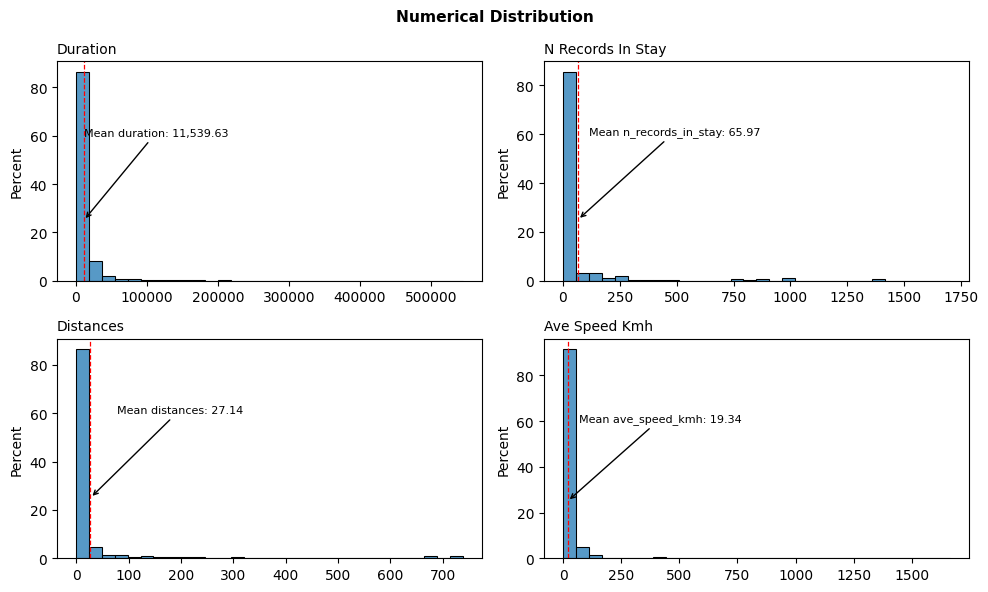

In [37]:
nrow, ncol = 2, 2
fig, ax = plt.subplots(nrow, ncol, figsize=(10,6))

cols = ['duration', 'n_records_in_stay', 'distances', 'ave_speed_kmh']
col_id = 0
for i in range(nrow):
    for j in range(ncol):
        mean_val = user_stays[cols[col_id]].mean()
        sns.histplot(user_stays, x=cols[col_id], ax=ax[i,j], kde=False, stat='percent', bins=30)
        ax[i, j].axvline(mean_val, linestyle='--', color='red', linewidth=0.9)
        ax[i, j].set(xlabel='')
        ax[i, j].set_title(cols[col_id].replace('_', ' ').title(), loc='left', fontsize=10)
        ax[i, j].annotate(f'Mean {cols[col_id]}: {mean_val:,.2f}',
                          fontsize=8, xy=(mean_val, 25), xytext=(mean_val+50, 60),
             arrowprops=dict(facecolor='black', arrowstyle='->',
                             connectionstyle = "arc, angleA = 0, angleB = 0, rad = 0")
             )
        col_id += 1
fig.suptitle('Numerical Distribution', fontsize=11.2, fontweight='bold')
fig.tight_layout()
plt.show()

- The average stay duration is by users is about 3 hours
- There is an average of 66 records in stay and an average total distance covered by users in the grid is about 27 kilometers.

__Stays by hour of day (start and end hour)__

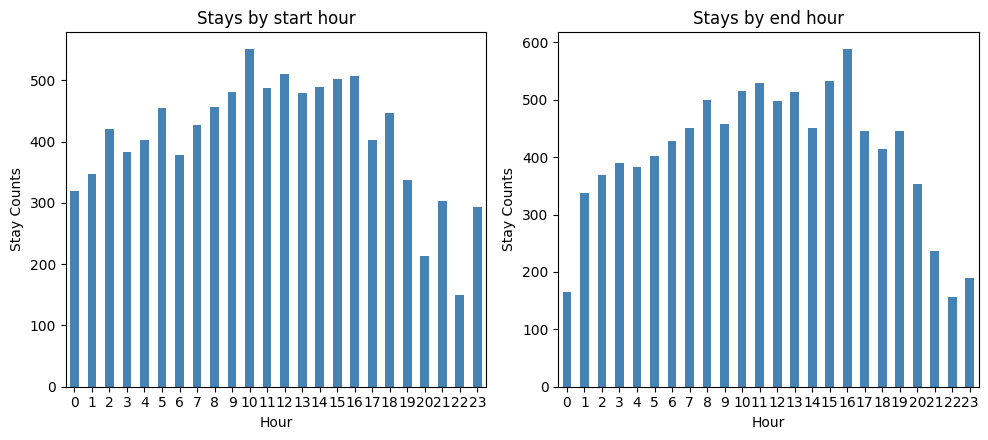

In [38]:
fig, ax = plt.subplots(1,2,figsize=(10,4.5))
user_stays.start_hour.value_counts().sort_index().plot.bar(ax=ax[0],
    rot=0, title='Stays by start hour', color='steelblue', xlabel='Hour', ylabel='Stay Counts')

user_stays.end_hour.value_counts().sort_index().plot.bar(ax=ax[1],
    rot=0, title='Stays by end hour', color='steelblue', xlabel='Hour', ylabel='Stay Counts')
fig.tight_layout()
plt.show()

- There are more stay occurrence by users during the rush hours of the morning and evening and also at noon.
- Probably these commuters are workers who have to leave their houses for work. A longer stay in the morning could be due to "busyness" of the traffic where commuters may be faced with bus/train delays and traffic jams.

__By Weekend and Weekdays__

- By stays
- By distance covered

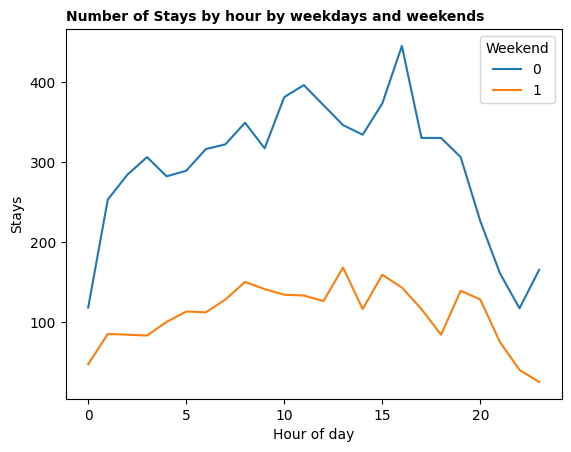

In [39]:
plt.figure()
sns.lineplot(user_stays.groupby(['end_hour', 'is_weekend']).size().reset_index(name='counts'),
             x='end_hour', y='counts', hue='is_weekend')
plt.ylabel('Stays')
plt.xlabel('Hour of day')
plt.title('Number of Stays by hour by weekdays and weekends',
          fontsize=10, fontweight='bold', loc='left')
plt.legend(title='Weekend')
plt.show()

- Stays are higher on weekdays than on weekends.
- Increases with hour of day and falls off toward the night, at either weekday or weekend

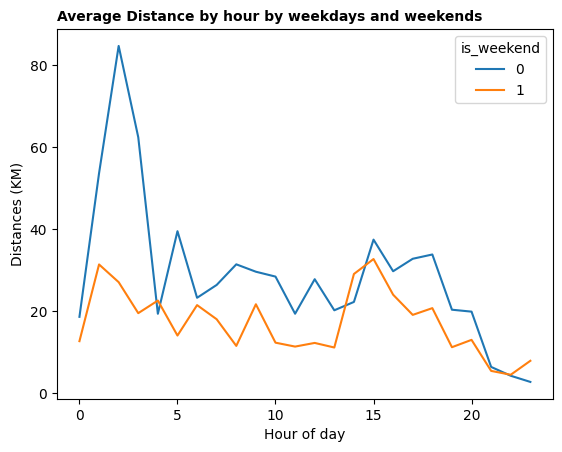

In [40]:
plt.figure()
sns.lineplot(user_stays.groupby(['end_hour', 'is_weekend']).distances.mean().reset_index(),
             x='end_hour', y='distances', hue='is_weekend')
plt.ylabel('Distances (KM)')
plt.xlabel('Hour of day')
plt.title('Average Distance by hour by weekdays and weekends', fontsize=10, fontweight='bold', loc='left')
plt.show()

- The distances on weekends and weekdays are different with shorter distances travelled on weekends.
- Thhe distances of both groups follow almost a similar pattern with longer late night distances (possibly for long distance travels), stable from the early hours of the day till about 2 PM, peaks a second time before declining towards the end of the day

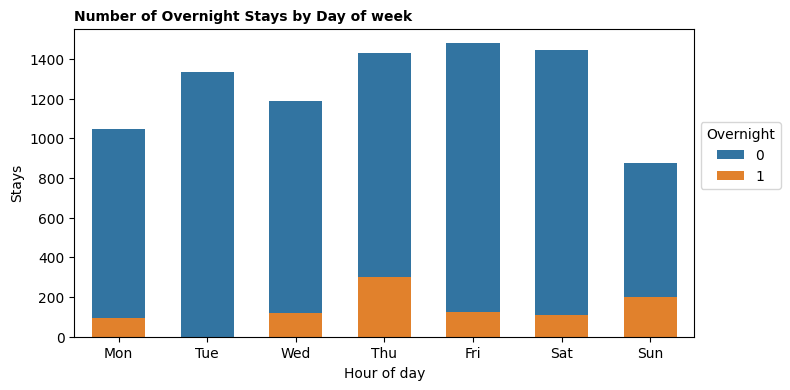

In [41]:
plt.figure(figsize=(8,4))
sns.barplot(user_stays.groupby(['dow', 'is_overnight']).size().reset_index(name='counts'),
             x='dow', y='counts', hue='is_overnight', dodge=False, width=0.6)
plt.ylabel('Stays')
plt.xlabel('Hour of day')
plt.title('Number of Overnight Stays by Day of week', fontsize=10, fontweight='bold', loc='left')
plt.xticks(range(7), ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'])
plt.legend(title='Overnight', loc=(1.01, 0.48))
plt.show()

__Mode of Transport used by users at stays__

In [42]:
def assign_transportation_mode(speed):
    """
    Assigns a mode of transport of user at stay
    """
    if speed == 0:
        return 'Stationary'
    elif 0 < speed <= 5:
        return 'Walking'
    elif 5 < speed <=15:
        return 'Jog|Run'
    elif 5 < speed <= 30:
        return 'Biking'
    elif 30 < speed <= 160:
        return "Car|Taxi|Train|Bus"
    elif 160 < speed < 450:
        return "High Speed Train"
    else:
        return "Anomalous (Likely Error)"

In [43]:
transport_modes = user_stays.ave_speed_kmh.apply(assign_transportation_mode)

In [44]:
user_stays['transport_mode'] = transport_modes

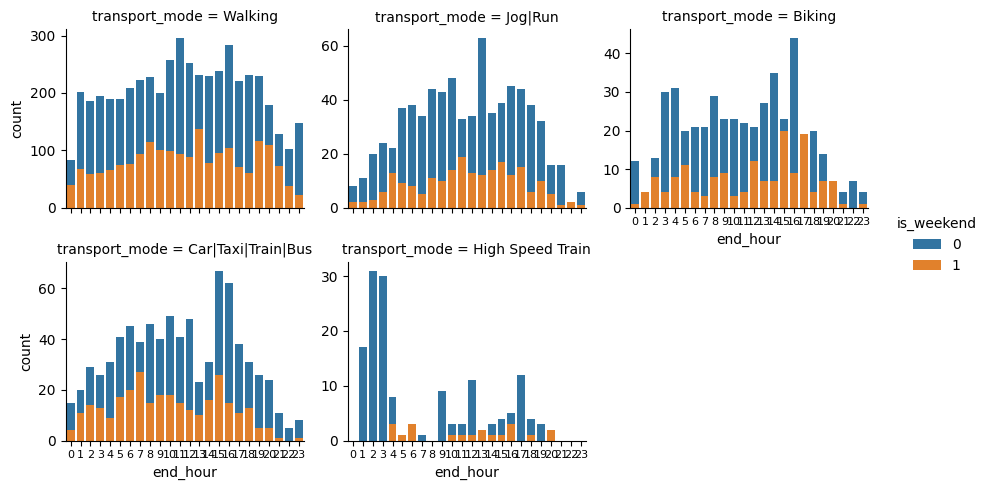

In [45]:
g = sns.catplot((
    user_stays
    .assign(transport_mode = user_stays.transport_mode.replace('Stat|Ano', np.nan, regex=True))
    .dropna()
    ), x='end_hour', hue='is_weekend', col='transport_mode', kind='count',
        col_wrap=3, sharey=False, height=2.5, aspect=1.2, dodge=False)
g.set_xticklabels(range(0,24), fontsize=8)
g.tight_layout()

- Most of the stays by users per hour of the day were made by walking. This is followed by bikes, trains and cars.
- For foot, bikes, and cars, the number increases with time and declines towards the evening. For speed train, there's more patronage at night possibly.

## __Task 5: Most Popular areas in the UAE__

- By stay counts
- By total distance covered
- Stay count by hour of day

In [46]:
# get mean distance and duration and most frequently used transport mode in areas
area_distances = user_stays.groupby(['area']).distances.mean().sort_values().to_dict()
area_duration = user_stays.groupby(['area']).duration.mean().sort_values().to_dict()
area_transport_mode = user_stays.groupby(['area']).transport_mode.apply(lambda x: x.mode()[0]).to_dict()

In [47]:
area_stay_counts = user_stays['area'].value_counts().to_dict()
overnight_counts = user_stays.query('is_overnight == 1').area.value_counts().to_dict()
weekend_counts = user_stays.query('is_weekend == 1').area.value_counts().to_dict()

In [48]:
# average stay per day (Daily stays)
avg_stays_per_day = user_stays.groupby(
    ['area','start_date']).size().groupby('area').mean().sort_values().round(2).to_dict()

In [49]:
def get_location_name(lat, lon):
    """
    Reverse Geocodes input coordinates
    Returns name and administration
    """
    res = rg.search((lat, lon), verbose=False)[0]
    return res['name'], res['admin1']

In [50]:
# geolocator.reverse
top_10_stay_sites = grid_areas.merge(
    pd.Series(area_stay_counts, name='counts'
             ).nlargest(10).reset_index(), right_on='index', left_on='area')

In [51]:
# get location name of top grid area by stays
top_stay_names = {}

for i, row in top_10_stay_sites.iterrows():
    area = row['area']
    res = get_location_name(row['center_lat'], row['center_lon'])
    top_stay_names[area]= res
    time.sleep(1)

In [52]:
def plot_area_distance(df, title=None, save_file=False, filename=None):

    r = folium.Map(location=(uae.latitude, uae.longitude), tiles="CartoDB Voyager", zoom_start=7,
                   max_bounds=True, min_lat=min_lat, min_lon=min_lon, max_lon=max_lon, max_lat=max_lat)

    heatmap_data = (
        grid_areas
        .join(user_stays.groupby(['area']).distances.mean(), on='area', how='inner')
    )
    heatmap_100_dist = heatmap_data.query('(distances >= 100)')
    heatmap_top_stays = heatmap_data.query(f'area in {list(top_stay_names.keys())}')

    heatmap_data = pd.concat([heatmap_100_dist, heatmap_top_stays],
                             ignore_index=True).drop('area', axis=1).drop_duplicates()


    title_html = '''
             <h3 align="center" style="font-size:16px"><b>{}</b></h3>
             '''.format(title)

    for name, count in df.items():
        cell_boundary = h3.cells_to_geo([name])
        polygon = folium.GeoJson(
            cell_boundary,
            style_function = lambda feature: {
                'fillColor' : 'white',
                'color' : 'transparent',
                'weight': 0.1,
                'fillOpacity' : 0.3 if name in top_stay_names else 0
            },
            tooltip = f"Grid Area: {name}\
                <br>Stay counts: {area_stay_counts.get(name, 0)}\
                    <br>Total Distance (KM): {count:.2f}\
                        <br>Average Duration (Hour): {area_duration.get(name, 0)/3600:.2f}\
                        <br>Frequent Transport mode: {area_transport_mode.get(name)}\
                        <br>Name: {top_stay_names.get(name)[0] if name in top_stay_names else np.nan}\
                            <br>Admin: {top_stay_names.get(name, 0)[1]  if name in top_stay_names else np.nan}"
        )

        polygon.add_to(r)
    r.get_root().html.add_child(folium.Element(title_html))
    plugins.HeatMap(heatmap_data[['center_lat', 'center_lon', 'distances']],  radius=25).add_to(r)
    if save_file:
        if filename:
            r.save(f'{filename}.html')
        else:
            r.save('area_stay_distances.html')
    else:
        return r

In [53]:
def plot_area_popularity(df, title=None, save_file=False, filename=None):

    r = folium.Map(location=(uae.latitude, uae.longitude), tiles="CartoDB Voyager", zoom_start=7,
                   max_bounds=True, min_lat=min_lat, min_lon=min_lon, max_lon=max_lon, max_lat=max_lat)

    heatmap_data = (
        pd.Series(df, name='counts').reset_index()
        .rename(columns={'index':'area'})
        .merge(grid_areas, on='area')
    ).drop('area', axis=1)

    title_html = '''
             <h3 align="center" style="font-size:16px"><b>{}</b></h3>
             '''.format(title)

    for name, count in df.items():
        cell_boundary = h3.cells_to_geo([name])
        polygon = folium.GeoJson(
            cell_boundary,
            style_function = lambda feature: {
                'fillColor' : '#ff0000',
                'color' : 'transparent',
                'weight': 1,
                'fillOpacity' : 0#0.8 if name in top_stay_names else 0.2
            },
            tooltip = f"Grid Area: {name}<br>Stay count: {count}\
                <br>Overnight counts: {overnight_counts.get(name, 0)}\
                    <br>Weekend counts: {weekend_counts.get(name, 0)}\
                        <br>Average Daily stays: {avg_stays_per_day.get(name)}\
                        <br>Name: {top_stay_names.get(name)[0] if name in top_stay_names else np.nan}\
                            <br>Admin: {top_stay_names.get(name, 0)[1]  if name in top_stay_names else np.nan}"
        )

        polygon.add_to(r)
    r.get_root().html.add_child(folium.Element(title_html))
    plugins.HeatMap(heatmap_data[['center_lat', 'center_lon', 'counts']].query('counts >= 40'),
                    radius=15).add_to(r)
    if save_file:
        if filename:
            r.save(f'{filename}.html')
        else:
            r.save('area_stay_popularity.html')
    else:
        return r

In [54]:
plot_area_popularity(area_stay_counts, title='Popular Areas in the UAE')

The map shows most popular areas in the UAE by stays (filtered by areas with 40 and above stays). From the map, we see that the regions near the ocean in Abu Dhabi and Dubai are the top 2 regions in the UAE with the most stays. By zooming in to Abu Dhabi, the top 2 areas by stays are located around Al Danah and Al Hisn. In Dubai, these top stay sites are located at Palm Jumeirah, Dubai Marina, Sharjah, and Al Khabisi districts.

Two areas in the Al Danah and Al Hisn regions in Abu Dhabi had a total of 292 and 332 stays, with over 100 overnight and weekend stays.

In [55]:
# area stay by total distance covered
plot_area_distance(area_distances, title='Area Stay total Distance')

The image shows areas by total distance taken in stays where the total distance covered is at least 100km in total.

From the image, the total distance covered by users in the two popular stay areas in Abu Dhabi is less than 8 hours compared to other areas in Abu Dhabi. Areas at the south of Abu Dhabi (specifically around Zayed city, Mohammed Bin Zayed city, and Shakhbout city axis) have more distances covered by users while on stay. Many users probably live there and may have to drive longer distances to commute to work. Other places in Abu Dhabi include Khalifa city an Al Falah.

Another region where commuters cover longer distances is Alain which include Al Sarouj, Mbazzarah Al Khadra and Shaib Al Ashkhar cities. In Dubai, these areas are within the Al Barsha, Ras Al Khor, Ajman and Sharjah regions axis.

In [56]:
hourly_stays = user_stays.groupby(['end_hour', 'area']).size().reset_index(name='hourly_stays')
hourly_stays = hourly_stays.merge(grid_areas, on='area', how='inner')

In [57]:
hourly_stays_list = []

for hour in range(24):
    hour_data = hourly_stays.query(f'end_hour == {hour}')
    hourly_stays_list.append(hour_data[['center_lat', 'center_lon', 'hourly_stays']].values.tolist())

In [58]:
def plot_area_popularity_overtime(title = 'Stays per hour of the day', save_file=False, filename=None):
    hour_map = folium.Map(location=(uae.latitude, uae.longitude), tiles="CartoDB Voyager", zoom_start=8,
                      max_bounds=True, min_lat=min_lat, min_lon=min_lon, max_lon=max_lon, max_lat=max_lat)
    title_html = '''
                <h3 align="center" style="font-size:16px"><b>{}</b></h3>
                '''.format(title)

    for i in range(24):
        df = hourly_stays.query(f'end_hour == {i}') # get hourly data
        top = df.query('hourly_stays >= 10').area.tolist()
        for j, row in df.iterrows():
            cell_boundary = h3.cells_to_geo([row['area']])
            polygon = folium.GeoJson(
                cell_boundary, overlay=False, show=True,
                style_function = lambda feature: {
                    'fillColor' : '#ff0000',
                    'color' : 'transparent',
                    'weight': 0.7,
                    'fillOpacity' : 0
                },
                tooltip=folium.Tooltip(
                text=f"Grid Area: {row['area']}<br>Stay count: {row['hourly_stays']}<br>Hour: {i}\
                            <br>Latitude: {row['center_lat']:.4f}<br>Longitude: {row['center_lon']:.4f}"
            ))
            polygon.add_to(hour_map)

    if save_file:
        if filename:
            r.save(f'{filename}.html')
        else:
            r.save('area_popularity_by_hour_of_day.html')

    hour_map.get_root().html.add_child(folium.Element(title_html))
    plugins.HeatMapWithTime(hourly_stays_list, index=list(range(24)), radius=20,
                            auto_play=True, overlay=False, max_opacity=0.2, min_speed=2).add_to(hour_map)
    return hour_map

In [59]:
plot_area_popularity_overtime()

The image shows how stays vary by hour of the day across geographical areas. From the image, we see that there are some regions where no stay was recorded at a particular hour of the day

## Task 6

If, given the opportunity, additional datasets that would be helpful would be demographics data, road transport data, and datasets that contain information to important sites such as businesses, recreational centers, tourist areas, landmarks etc. The demographics data would provide information about the population of people in different areas. It can help in understanding the "kind" of people staying within a grid area. Road transport network data, on the other hand, would provide information about the road and public transport routes in the area giving us the idea on determining how people are travelling to and from their stays. In addition, a dataset that contains the number of shops, recreational parks, tourist sites, restaurants, social event centers, businesses etc in a given area would help in understanding the kinds of activities people are engaging in during their stays.

To apply this solution in production when dealing with real-life volumes of data would involve the following:

- Developing a production pipeline that ingests, processes and aggregates real-life data.
- This pipeline also needs to be scalable. Scalability could involve using different chunks either by partitioning the dataset into smaller chunks or employing distributed computing frameworks such as Spark
- Another strategy would be to adopt cloud computing to perform tasks instead of using live-computer hardware to store data and manage data volume. Using cloud computing services such as Azure, Google cloud and AWS, could help save money in buying storage and hardware devices to manage huge amounts of computing. These services have been integrated with data analytics capabilities and can be used to visualize stays in real-time

---

### __Summary__

In this notebook, we analysed 903 user mobility records obtained from 1-7 of November, 2023. Data exploration such as checking for missing values, data types, performing summary statistics and visualising the distribution, were performed to understand the dataset and come up with better strategies of preprocessing it to suit the purpose. From the result of the data exploration step, raw dataset was prepared/transformed into a format suitable for analysis. A hexagonal gridding system of resolution 8 was chosen to split the coordinates into grid areas.

A duration lasting at least 15 minutes was chosen as a cutoff to define a stay. Preparation was done such that the timestamp preceding the criteria was assigned to be the start time while the timestamp the user moved out of the grid area or marked the end of user record was assigned to be the end time of the user's stay within the grid area and the duration from stay till end time was aggregated to be the duration of user in stay. Distances between consecutive user records were calculated and aggregated to obtain the total distance covered by user within the stay period.

Next, data analysis and visualisation was done to understand stays. The following questions were explored during analysis:
- The distribution of stay events at each time of the day from 12 AM to 11:59 PM
- Stay popularity at weekdays and weekends.
- Overnight stays by weekday
- Most frequent used mode of transport
- Stay popular areas
- Total distance covered by users in stay areas
- Stay popularity per hour in all areas

Findings

- It was found that number of stays increases across the hour of the day before declining towards the end of the day. It is possible that stays during working hours indicate that users are at work or somewhere near work areas either to have lunch at a restaurant. It is also possible that some user stays may occur when the user is stuck at traffic. We see higher stays towards the close of work hours

- Also, stay popularity differ by weekday and weekend with more stay popularity on weekdays. Also, total distance covered during stays on weekdays and weekends, differ. More distance is covered by users on weekdays than on weekends with sharp increase at the early hours of the morning between 1-2 AM and evening (4-6PM).

- It is likely that users mostly walk to get to their stays; either to get to work, grocery shop, parks, gym, etc. It is also possible that jog or run, or use other means of transport like car, train, bus to get to their stay destinations. Looking closely, we see that in the early hours of the morning high-speed trains are used to get to stay destinations. Probably, this means of transport is used to commute to work, maybe in another city.

- Popular stays occur in cities in Abu Dhabi, Sharjah and Dubai regions. Top cities include Al Danah, Al Hisn, Dubai Marina, Al Khbisi and Sharjah. These regions are the top most populous cities in the UAE and is expected to have lots of businesses, parks, recreational centers and also an airport. There's no difference in their popularity by hour of the day, indicating that they are lively cities where people can engage in various night and day life activities.

In conclusion, based on our insights, mobile analytics provide huge potential for modern urban planning by providing information about the resident aceptance of public facilities, identifying unusual congestion of people in a location and understanding the distance taken by residents to get to a stay for the establishment of new public facilities.